In [131]:
import pandas as pd
import os
import math
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

from datetime import datetime
from sklearn.preprocessing import MinMaxScaler
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import RobustScaler

from collections import defaultdict
import gurobipy as grb
from gurobipy import GRB

## Ad Data

In [40]:
path = os.getcwd()
ad_df = pd.read_excel(f"{path}/data/ad_ranking_raw_data.xlsx")

In [41]:
ad_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 40679 entries, 0 to 40678
Data columns (total 12 columns):
 #   Column                    Non-Null Count  Dtype         
---  ------                    --------------  -----         
 0   p_date                    40679 non-null  int64         
 1   ad_id                     40679 non-null  int64         
 2   delivery_country          40679 non-null  object        
 3   queue_market              19524 non-null  object        
 4   punish_num                2393 non-null   float64       
 5   latest_punish_begin_date  40679 non-null  datetime64[ns]
 6   ad_revenue                29908 non-null  float64       
 7   avg_ad_revenue            40679 non-null  float64       
 8   start_time                34004 non-null  datetime64[ns]
 9   baseline_st               40679 non-null  float64       
 10  product_line              40679 non-null  object        
 11  task_type_en              40679 non-null  object        
dtypes: datetime64[ns](

### Data Cleaning

In [42]:
clean_df = ad_df
clean_df["punish_num"] = clean_df["punish_num"].fillna(0)

In [43]:
# Get the current date and time
curr_datetime = datetime.now()

# Fill empty values in the 'date_column' with the current date and time
clean_df['start_time'].fillna(curr_datetime, inplace=True)

In [44]:
# Get new column of days after start time where account gets last punished
clean_df["punish_after_start_time"] = clean_df["latest_punish_begin_date"] - clean_df["start_time"]
clean_df["punish_after_start_time"] = clean_df["punish_after_start_time"].dt.days
clean_df.loc[clean_df["punish_after_start_time"] < 0, "punish_after_start_time"] = 0

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: 

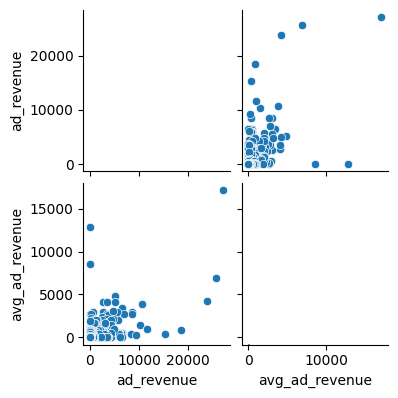

In [45]:
sns.pairplot(ad_df[["ad_revenue", "avg_ad_revenue"]], height=2)
plt.show() 

/var/folders/n5/nyw3dq1s69nd91ynn_2b589r0000gn/T/ipykernel_763/808476529.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.dropna(inplace=True)
/var/folders/n5/nyw3dq1s69nd91ynn_2b589r0000gn/T/ipykernel_763/808476529.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp["avg_ad_revenue"] = [math.sqrt(x) for x in temp["avg_ad_revenue"]]
/var/folders/n5/nyw3dq1s69nd91ynn_2b589r0000gn/T/ipykernel_763/808476529.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value in

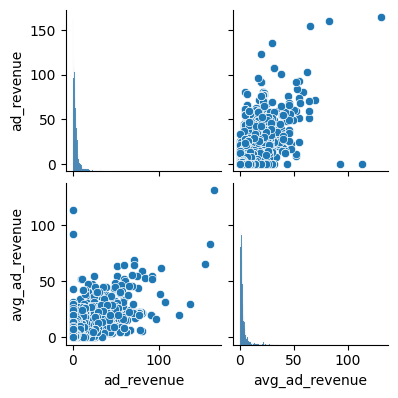

In [46]:
temp = ad_df[["ad_revenue", "avg_ad_revenue"]]
temp.dropna(inplace=True)
temp["avg_ad_revenue"] = [math.sqrt(x) for x in temp["avg_ad_revenue"]]
temp["ad_revenue"] = [math.sqrt(x) for x in temp["ad_revenue"]]

sns.pairplot(temp, height=2)
plt.show() 

In [47]:
temp.corr()

,ad_revenue,avg_ad_revenue
ad_revenue,1.000000,0.732195
avg_ad_revenue,0.732195,1.000000


In [48]:
# Avg ad revenue & ad revenue are somewhat linear -> used LR to map missing ad revenue values
cols_to_clean = ['ad_revenue']
temp_df = ad_df.dropna(subset = cols_to_clean)

# Square root transformation
temp_df.loc[temp_df["ad_revenue"] > 0, "ad_revenue"] = [math.sqrt(num) for num in temp_df.loc[temp_df["ad_revenue"] > 0, "ad_revenue"]]
temp_df.loc[temp_df["avg_ad_revenue"] > 0, "avg_ad_revenue"] = [math.sqrt(num) for num in temp_df.loc[temp_df["avg_ad_revenue"] > 0, "avg_ad_revenue"]]

# Sample data
X = np.array(temp_df["avg_ad_revenue"])  # Independent variable
Y = np.array(temp_df["ad_revenue"])  # Dependent variable

# Create a Linear Regression model
model = LinearRegression()

# Fit the model to the data
model.fit(X.reshape(-1, 1), Y)

# Obtain the coefficients
beta_0 = model.intercept_
beta_1 = model.coef_[0]

for index, row in clean_df.iterrows():

    sqrt_avg_rev = math.sqrt(clean_df.at[index, "avg_ad_revenue"])
    clean_df.at[index, "avg_ad_revenue"] = sqrt_avg_rev
    
    if pd.isna(row["ad_revenue"]):
        # Predict the missing ad_revenue value using the linear regression equation
        predicted_ad_revenue = beta_1 * sqrt_avg_rev + beta_0
        clean_df.at[index, "ad_revenue"] = predicted_ad_revenue
    else:
        sqrt_ad_rev = math.sqrt(clean_df.at[index, "ad_revenue"])
        clean_df.at[index, "ad_revenue"] = sqrt_ad_rev

clean_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 40679 entries, 0 to 40678
Data columns (total 13 columns):
 #   Column                    Non-Null Count  Dtype         
---  ------                    --------------  -----         
 0   p_date                    40679 non-null  int64         
 1   ad_id                     40679 non-null  int64         
 2   delivery_country          40679 non-null  object        
 3   queue_market              19524 non-null  object        
 4   punish_num                40679 non-null  float64       
 5   latest_punish_begin_date  40679 non-null  datetime64[ns]
 6   ad_revenue                40679 non-null  float64       
 7   avg_ad_revenue            40679 non-null  float64       
 8   start_time                40679 non-null  datetime64[ns]
 9   baseline_st               40679 non-null  float64       
 10  product_line              40679 non-null  object        
 11  task_type_en              40679 non-null  object        
 12  punish_after_start

### Robust Scaling & Min-Max Scaling

In [49]:
# columns used as features for the optimisation
num_cols = ["punish_num", "ad_revenue",	"avg_ad_revenue", "baseline_st", "punish_after_start_time"]

In [50]:
scaler = RobustScaler()

# perform robust scaling on the df
scaled_array = scaler.fit_transform(clean_df[num_cols])
scaled_df = pd.DataFrame(data=scaled_array, columns=num_cols)

In [52]:
# negative values affect the performance of Gurobipy -> add min value of each column if negative to all values -> min value wold be 0
min_ad_revenue = scaled_df["ad_revenue"].min()
if min_ad_revenue < 0:
    scaled_df["ad_revenue"] += -min_ad_revenue

min_avg_ad = scaled_df["avg_ad_revenue"].min()
if min_avg_ad < 0:
    scaled_df["avg_ad_revenue"] += -min_avg_ad

min_baseline = scaled_df["baseline_st"].min()
if min_baseline < 0:
    scaled_df["baseline_st"] += -min_baseline

scaled_df

,punish_num,ad_revenue,avg_ad_revenue,baseline_st,punish_after_start_time
0,1.0,25.369276,35.300149,1.000000,272.0
1,1.0,15.742674,16.626245,0.911290,111.0
2,2.0,0.466520,1.180744,1.048387,374.0
3,2.0,1.238282,1.180744,0.838710,374.0
4,2.0,0.437313,1.180744,0.838710,374.0
...,...,...,...,...,...
40674,0.0,0.191905,0.000000,0.000000,0.0
40675,0.0,0.191905,0.000000,0.000000,0.0
40676,0.0,0.191905,0.000000,0.000000,0.0
40677,0.0,0.191905,0.000000,0.000000,0.0


In [53]:
# perform min-max scaling to scale all columns to values between 0 and 1
scaler = MinMaxScaler()
scaled_array_df_2 = scaler.fit_transform(scaled_df)

scaled_df_2 = pd.DataFrame(data=scaled_array_df_2, columns=num_cols)
scaled_df_2

,punish_num,ad_revenue,avg_ad_revenue,baseline_st,punish_after_start_time
0,0.0625,0.435172,0.528863,0.175887,0.542914
1,0.0625,0.270042,0.249093,0.160284,0.221557
2,0.1250,0.008002,0.017690,0.184397,0.746507
3,0.1250,0.021241,0.017690,0.147518,0.746507
4,0.1250,0.007501,0.017690,0.147518,0.746507
...,...,...,...,...,...
40674,0.0000,0.003292,0.000000,0.000000,0.000000
40675,0.0000,0.003292,0.000000,0.000000,0.000000
40676,0.0000,0.003292,0.000000,0.000000,0.000000
40677,0.0000,0.003292,0.000000,0.000000,0.000000


### Data Viz

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: 

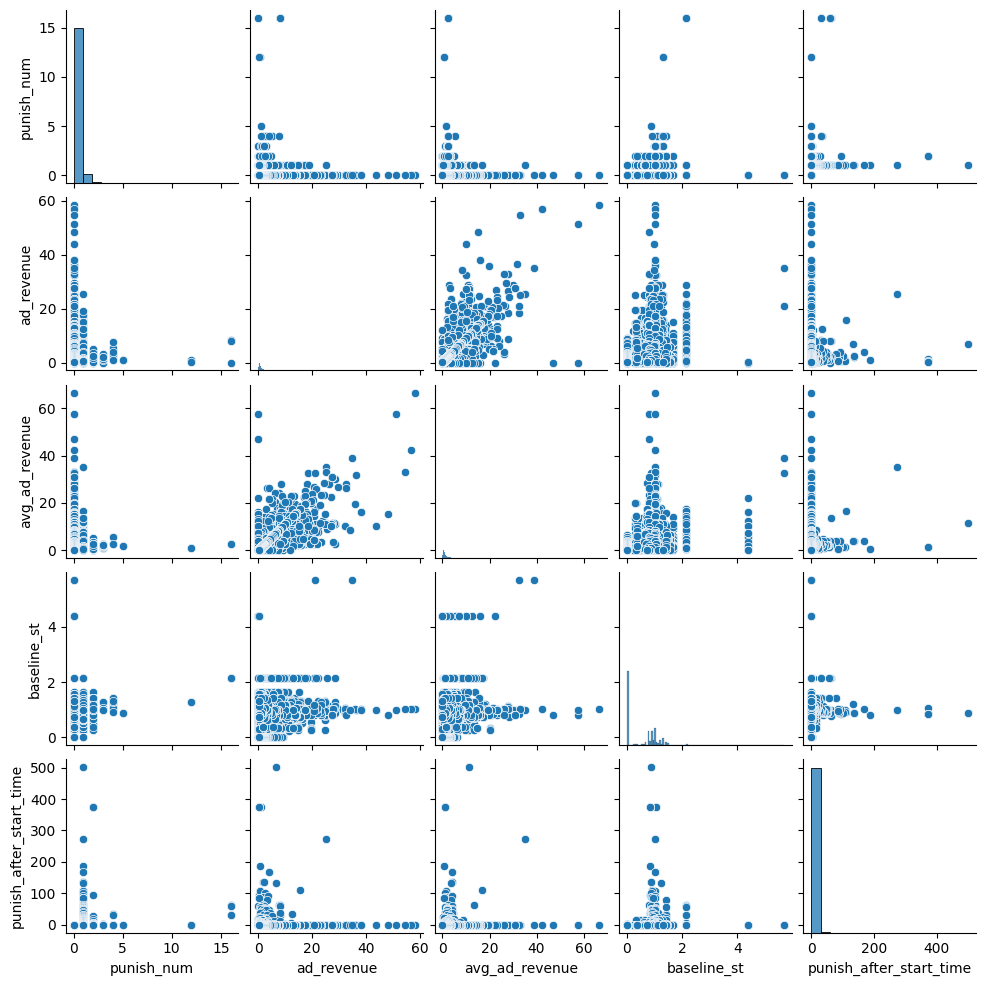

In [54]:
# visualise pairplots of all columns for the optimisation
sns.pairplot(scaled_df, height=2)
plt.show() 

### Gurobipy 

In [56]:
# initialise grb model
model = grb.Model("ads_optimisation")

In [57]:
# initialise variables for weights
w1 = model.addVar(lb=0, ub=1000, vtype=GRB.CONTINUOUS, name="baseline")
w2 = model.addVar(lb=0, ub=1000, vtype=GRB.CONTINUOUS, name="avg_ad_rev")
w3 = model.addVar(lb=0, ub=1000, vtype=GRB.CONTINUOUS, name="punishNum")
w4 = model.addVar(lb=0, ub=1000, vtype=GRB.CONTINUOUS, name="punish_duration")
w5 = model.addVar(lb=0, ub=1000, vtype=GRB.CONTINUOUS, name="ad_rev")
w6 = model.addVar(lb=0.0001, ub=10, vtype=GRB.CONTINUOUS, name="placeholder")

In [58]:
# get column values as lists
punish_dur = scaled_df_2['punish_after_start_time'].tolist()
baseline = scaled_df_2['baseline_st'].tolist()
punish_num = scaled_df_2['punish_num'].tolist()
avg_ad_rev = scaled_df_2['avg_ad_revenue'].tolist()
ad_rev = scaled_df_2['ad_revenue'].tolist()

# intialise lists to store scores for each col
baseline_scores = []
avg_ad_scores = []
punishNum_scores = []
punish_duration = []
rev_scores = []
final_score = []

# for each ad
for i in range(len(baseline)):

    # construct MLR eqn
    model.setObjective(
        expr = baseline[i] * w1 + w2 * avg_ad_rev[i] + w3 * punish_num[i] + punish_dur[i] * w4 + w5 * ad_rev[i],
        sense = GRB.MAXIMIZE
    )

    # add weight constraints to rank importance of each variable
    model.addConstr(w1 >= w2 + 0.0001, name="w1_gt_w2")
    model.addConstr(w2 >= w3 + 0.0001, name="w2_gt_w3")
    model.addConstr(w3 >= w4 + 0.0001, name="w3_gt_w4")
    model.addConstr(w4 >= w5 + 0.0001, name="w4_gt_w5")
    model.addConstr(w5 >= w6, name="w5_gt_0")

    # Add upper and lower bound constraints for each variable
    model.addConstr(baseline[i] * w1 + w2 * avg_ad_rev[i] + w3 * punish_num[i] + punish_dur[i] * w4 + w5 * ad_rev[i] <= 1, name=f"upper_bound_{i}")
    model.addConstr(baseline[i] * w1 + w2 * avg_ad_rev[i] + w3 * punish_num[i] + punish_dur[i] * w4 + w5 * ad_rev[i] >= 0, name=f"lower_bound_{i}")

    model.update()
    model.optimize()

    # Check if an optimal solution was found
    if model.status == GRB.OPTIMAL:
        # Retrieve and print the optimal values of decision variables
        optimal_w1 = w1.x
        optimal_w2 = w2.x
        optimal_w3 = w3.x
        optimal_w4 = w4.x
        optimal_w5 = w5.x

        # Retrieve and print the optimal objective value
        optimal_objective_value = model.objVal

        baseline_scores.append(optimal_w1)
        avg_ad_scores.append(optimal_w2)
        punishNum_scores.append(optimal_w3)
        punish_duration.append(optimal_w4)
        rev_scores.append(optimal_w5)
        final_score.append(optimal_objective_value)

        print(i)
    else:
        print("No optimal solution found.")

Gurobi Optimizer version 10.0.2 build v10.0.2rc0 (mac64[arm])

CPU model: Apple M1 Pro
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 7 rows, 6 columns and 20 nonzeros
Model fingerprint: 0x474799e4
Coefficient statistics:
  Matrix range     [6e-02, 1e+00]
  Objective range  [6e-02, 5e-01]
  Bounds range     [1e-04, 1e+03]
  RHS range        [1e-04, 1e+00]
Presolve removed 7 rows and 6 columns
Presolve time: 0.00s
Presolve: All rows and columns removed
Iteration    Objective       Primal Inf.    Dual Inf.      Time
       0    1.0000000e+00   0.000000e+00   0.000000e+00      0s

Solved in 0 iterations and 0.00 seconds (0.00 work units)
Optimal objective  1.000000000e+00
0
Gurobi Optimizer version 10.0.2 build v10.0.2rc0 (mac64[arm])

CPU model: Apple M1 Pro
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 14 rows, 6 columns and 40 nonzeros
Coefficient statistics:
  Matrix range     [6e-

In [59]:
# initialise output df for ads
ad_checker = pd.DataFrame()

ad_checker['punish_num'] = punishNum_scores
ad_checker['ad_rev'] = rev_scores
ad_checker['avg_rev'] = avg_ad_scores
ad_checker['baseline'] = baseline_scores
ad_checker['punish_duration'] = punish_duration
ad_checker['final'] = final_score

ad_checker

,punish_num,ad_rev,avg_rev,baseline,punish_duration,final
0,0.000300,0.000100,0.000400,5.683310,0.000200,1.000000
1,0.000300,0.000100,0.000400,5.683310,0.000200,0.911132
2,0.064696,0.064496,0.064796,5.108695,0.064596,1.000000
3,0.160922,0.000100,0.161022,4.647474,0.160822,0.828605
4,0.160922,0.000100,0.161022,4.647474,0.160822,0.828604
...,...,...,...,...,...,...
40674,0.457716,0.457516,0.457816,0.457916,0.457616,0.001506
40675,0.457716,0.457516,0.457816,0.457916,0.457616,0.001506
40676,0.457716,0.457516,0.457816,0.457916,0.457616,0.001506
40677,0.457716,0.457516,0.457816,0.457916,0.457616,0.001506


In [60]:
clean_df["final_score"] = ad_checker["final"]

<Axes: >

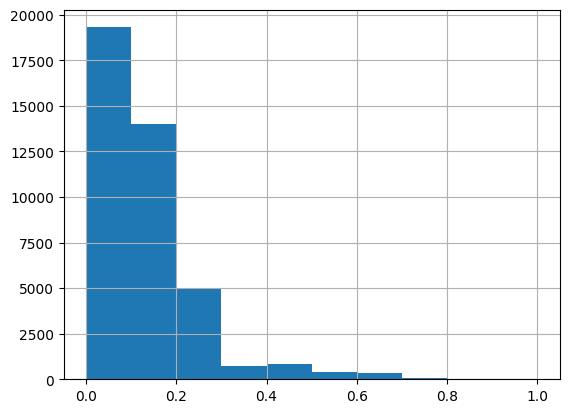

In [61]:
# Raw final score data -> right-skewed
clean_df["final_score"].hist()

<Axes: >

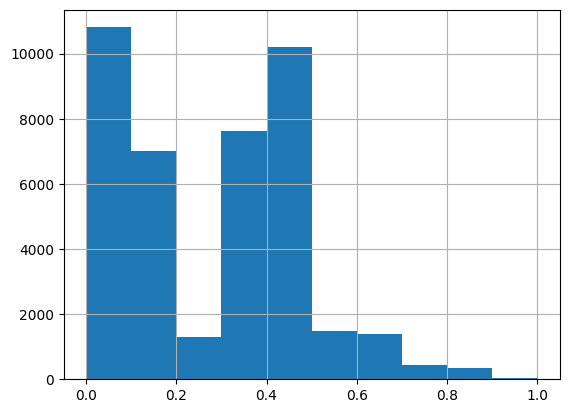

In [78]:
# Perform square-root transformation for final scores
clean_df["final_score_transformed"] = [math.sqrt(x) for x in clean_df["final_score"]]
clean_df["final_score_transformed"].hist()

In [79]:
# output ad data with final score as a csv
clean_df["final_score"] = clean_df["final_score_transformed"]
clean_df.drop(columns=['final_score_transformed'], inplace=True)

clean_df.to_csv('intermediate/ads_data.csv', index=False)